In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium as folium
import sys
print(sys.executable)
df = pd.read_parquet('../data/raw/lightning_batch_0000.parquet')
# verify data shows what we expect
print(df.head())

/Users/wittenpan/Desktop/Lightning-Project/.venv/bin/python
                  time        lat        lon  alt  pol    mds  mcg  status  \
0  1762673451849563600  28.716077 -79.642624    0    0   6989  166       2   
1  1762673451849563600  28.716077 -79.642624    0    0   6989  166       1   
2  1762673448455862000  31.236293 -90.875692    0    0  13439  153       0   
3  1762673451849608400  28.840827 -79.609282    0    0   9044  254       0   
4  1762673454689974500  13.064168 -83.253154    0    0   9420  208       2   

   region                                                sig  delay  lonc  \
0       9  [{'alt': 8, 'lat': 26.967628, 'lon': -80.09736...    1.7     0   
1       8  [{'alt': 8, 'lat': 26.967628, 'lon': -80.09736...    1.8     0   
2       4  [{'alt': 158, 'lat': 39.442837, 'lon': -91.062...    5.5     0   
3       1  [{'alt': 8, 'lat': 26.967628, 'lon': -80.09736...    2.6     0   
4       9  [{'alt': 2586, 'lat': 4.715479, 'lon': -74.088...    0.4     0   

   latc 

In [2]:
lats = df['lat'].values
lons = df['lon'].values
#plot on map to see the distribution of the data
m = folium.Map(location=[0, 0], zoom_start=2)
from folium.plugins import FastMarkerCluster
FastMarkerCluster(data=list(zip(lats, lons))).add_to(m)
#render inline (this is really cool)
m
del m

In [3]:
import h3
from collections import Counter

#load all batches for complete analysis
all_dfs = []
for i in range(4):
    batch_df = pd.read_parquet(f'../data/raw/lightning_batch_{i:04d}.parquet')
    all_dfs.append(batch_df)

df_full = pd.concat(all_dfs, ignore_index=True)
print(f"Total lightning strikes: {len(df_full):,}")
print(f"Date range: {pd.to_datetime(df_full['time'], unit='ns').min()} to {pd.to_datetime(df_full['time'], unit='ns').max()}")


Total lightning strikes: 370,000
Date range: 2025-11-09 07:30:47.184956 to 2025-11-10 03:30:00.420634600


In [4]:
#resolution 7: ~5.16 km^2 average area (~2.7 km edge length, good for meteorological patterns)
#resolution 6: ~36.1 km^2 average area (~10 km edge length, regional patterns)
#resolution 8: ~0.74 km^2 average area (~1 km edge, very detailed)
RESOLUTION = 7

#convert lat/lon to H3 cells
df_full['h3_cell'] = df_full.apply(lambda row: h3.latlng_to_cell(row['lat'], row['lon'], RESOLUTION), axis=1)

print(f"Using H3 resolution {RESOLUTION}")
print(f"Average hex area: ~5.16 km²")
print(f"Average hex edge: ~2.7 km")
print(f"\nUnique H3 cells with lightning: {df_full['h3_cell'].nunique():,}")


Using H3 resolution 7
Average hex area: ~5.16 km²
Average hex edge: ~2.7 km

Unique H3 cells with lightning: 105,160


In [5]:
#analyze strike distribution per H3 cell
cell_strikes = df_full['h3_cell'].value_counts()
print("=== Strike Distribution Analysis ===")
print(f"Total cells with strikes: {len(cell_strikes):,}")
print(f"\nStrikes per cell statistics:")
print(f"  Mean: {cell_strikes.mean():.2f}")
print(f"  Median: {cell_strikes.median():.0f}")
print(f"  Std Dev: {cell_strikes.std():.2f}")
print(f"  Min: {cell_strikes.min()}")
print(f"  Max: {cell_strikes.max()}")

#distribution by strike count
print(f"\n=== Cell Distribution by Strike Count ===")
strike_ranges = [
    (1, 1, "1 strike"),
    (2, 5, "2-5 strikes"),
    (6, 10, "6-10 strikes"),
    (11, 20, "11-20 strikes"),
    (21, 50, "21-50 strikes"),
    (51, float('inf'), ">50 strikes")
]

for min_s, max_s, label in strike_ranges:
    count = len(cell_strikes[(cell_strikes >= min_s) & (cell_strikes <= max_s)])
    pct = 100 * count / len(cell_strikes)
    print(f"  {label:20s}: {count:6,} cells ({pct:5.2f}%)")

#identify hotspot cells (>5 strikes for future ml training)
hotspot_cells = cell_strikes[cell_strikes > 5]
print(f"\n=== Hotspot Analysis (>5 strikes) ===")
print(f"Hotspot cells: {len(hotspot_cells):,} ({100*len(hotspot_cells)/len(cell_strikes):.2f}% of all cells)")
print(f"Total strikes in hotspots: {hotspot_cells.sum():,} ({100*hotspot_cells.sum()/len(df_full):.2f}% of all strikes)")


=== Strike Distribution Analysis ===
Total cells with strikes: 105,160

Strikes per cell statistics:
  Mean: 3.52
  Median: 2
  Std Dev: 5.04
  Min: 1
  Max: 87

=== Cell Distribution by Strike Count ===
  1 strike            : 44,666 cells (42.47%)
  2-5 strikes         : 43,608 cells (41.47%)
  6-10 strikes        : 10,546 cells (10.03%)
  11-20 strikes       :  4,584 cells ( 4.36%)
  21-50 strikes       :  1,619 cells ( 1.54%)
  >50 strikes         :    137 cells ( 0.13%)

=== Hotspot Analysis (>5 strikes) ===
Hotspot cells: 16,886 (16.06% of all cells)
Total strikes in hotspots: 198,658 (53.69% of all strikes)


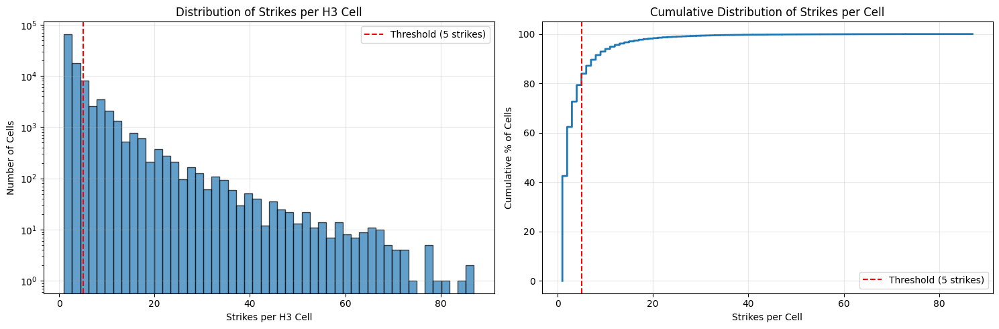

In [6]:
#visualize strike distribution
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

#histogram of strikes per cell (log scale)
axes[0].hist(cell_strikes.values, bins=50, edgecolor='black', alpha=0.7)
axes[0].set_xlabel('Strikes per H3 Cell')
axes[0].set_ylabel('Number of Cells')
axes[0].set_title('Distribution of Strikes per H3 Cell')
axes[0].axvline(x=5, color='r', linestyle='--', label='Threshold (5 strikes)')
axes[0].set_yscale('log')
axes[0].legend()
axes[0].grid(True, alpha=0.3)

#cumulative distribution
sorted_strikes = np.sort(cell_strikes.values)
cumulative = np.arange(1, len(sorted_strikes) + 1) / len(sorted_strikes) * 100
axes[1].plot(sorted_strikes, cumulative, linewidth=2)
axes[1].set_xlabel('Strikes per Cell')
axes[1].set_ylabel('Cumulative % of Cells')
axes[1].set_title('Cumulative Distribution of Strikes per Cell')
axes[1].axvline(x=5, color='r', linestyle='--', label='Threshold (5 strikes)')
axes[1].grid(True, alpha=0.3)
axes[1].legend()

plt.tight_layout()
plt.show()


In [7]:
#ceate aggregated cell data for visualization
cell_data = []
for cell_id, count in cell_strikes.items():
    lat, lon = h3.cell_to_latlng(cell_id)
    cell_data.append({
        'h3_cell': cell_id,
        'lat': lat,
        'lon': lon,
        'strike_count': count,
        'is_hotspot': count > 5
    })

df_cells = pd.DataFrame(cell_data)
print(f"Created aggregated cell dataset: {len(df_cells):,} cells")
print(f"\nSample of top 10 hotspot cells:")
print(df_cells.nlargest(10, 'strike_count')[['lat', 'lon', 'strike_count', 'is_hotspot']])


Created aggregated cell dataset: 105,160 cells

Sample of top 10 hotspot cells:
         lat        lon  strike_count  is_hotspot
0  29.468157 -78.073249            87        True
1  39.082625  14.009400            86        True
2  28.530777 -79.096526            84        True
3  28.551472 -79.090326            81        True
4  28.452937 -79.099884            79        True
5  29.472747 -78.051924            78        True
6  28.510079 -79.102724            77        True
7  28.494336 -79.087493            77        True
8  37.381003  15.715510            77        True
9  28.567221 -79.105566            77        True


In [8]:
#visualize H3 hexagons on map with color-coded density
import branca.colormap as cm
#create map centered on data
center_lat = df_cells['lat'].mean()
center_lon = df_cells['lon'].mean()
m = folium.Map(location=[center_lat, center_lon], zoom_start=3, tiles='CartoDB positron')

#create colormap based on strike counts (log scale)
min_strikes = df_cells['strike_count'].min()
max_strikes = df_cells['strike_count'].max()
colormap = cm.LinearColormap(
    colors=['yellow', 'orange', 'red', 'darkred'],
    vmin=np.log1p(min_strikes),
    vmax=np.log1p(max_strikes),
    caption='Lightning Strikes per H3 Cell (log scale)'
)

#sample cells for visualization (plotting all cells would be too heavy)
#focus on hotspots and random sample of others
hotspot_cells_viz = df_cells[df_cells['is_hotspot']]
other_cells_sample = df_cells[~df_cells['is_hotspot']].sample(min(1000, len(df_cells[~df_cells['is_hotspot']])))
cells_to_plot = pd.concat([hotspot_cells_viz, other_cells_sample])

print(f"Plotting {len(cells_to_plot):,} H3 cells ({len(hotspot_cells_viz):,} hotspots + {len(other_cells_sample):,} sampled others)")

#add hexagons to map
for idx, row in cells_to_plot.iterrows():
    #get hexagon boundary
    hex_boundary = h3.cell_to_boundary(row['h3_cell'])
    
    #convert to lat/lon format for folium (need to reverse from h3's format)
    hex_coords = [[lat, lon] for lat, lon in hex_boundary]
    
    #color by strike density
    color = colormap(np.log1p(row['strike_count']))
    
    #add polygon
    folium.Polygon(
        locations=hex_coords,
        color=color,
        fill=True,
        fillColor=color,
        fillOpacity=0.6 if row['is_hotspot'] else 0.3,
        weight=2 if row['is_hotspot'] else 1,
        popup=f"Strikes: {row['strike_count']}<br>Cell: {row['h3_cell']}",
        tooltip=f"{row['strike_count']} strikes"
    ).add_to(m)

#add colormap to map
colormap.add_to(m)

m


Plotting 17,886 H3 cells (16,886 hotspots + 1,000 sampled others)
